 <a href="https://colab.research.google.com/github/JasonGross/neural-net-coq-interp/blob/main/writeups/Formalizing_Transformers_For_Mech_Interp_Folks_Max_of_small_n_Jason_Gross%2C_Thomas_Kwa%2C_Rajashree_Agrwal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Formalizing Transformers, For Mech Interp Folks


In [*Towards Monosemanticity: Decomposing Language Models With Dictionary Learning*](https://transformer-circuits.pub/2023/monosemantic-features), Bricken et al. say:
> #### How can we tell if the autoencoder is working?
>
> Usually in machine learning we can quite easily tell if a method is working by looking at an easily-measured quantity like the test loss. We spent quite some time searching for an equivalent metric to guide our efforts here, and unfortunately have yet to find anything satisfactory.
>
> We began by looking for an information-based metric, so that we could say in some sense that the best factorization is the one that minimizes the total information of the autoencoder and the data. Unfortunately, this total information did not generally correlate with subjective feature interpretability or activation sparsity. (Runs whose feature activations had an average L0 norm in the hundreds but low reconstruction error could have lower total information than those with smaller average L0 norm and higher reconstruction error.)
>
> Thus we ended up using a combination of several additional metrics to guide our investigations:
>
> 1. **Manual inspection:** Do the features seem interpretable?
> 2. **Feature density:** we found that the number of “live” features and the percentage of tokens on which they fire to be an extremely useful guide. (See appendix for details.)
> 3. **Reconstruction loss:** How well does the autoencoder reconstruct the MLP activations? Our goal is ultimately to explain the function of the MLP layer, so the MSE loss should be low.
> 4. **Toy models:** Having toy models where we know the ground truth and so can cleanly evaluate the autoencoder’s performance was crucial to our early progress.
>
>Interpreting or measuring some of these signals can be difficult, though. For instance, at various points we thought we saw features which at first didn’t make any sense, but with deeper inspection we could understand. Likewise, while we have identified some desiderata for the distribution of feature densities, there is much that we still do not understand and which prevents this from providing a clear signal of progress.
>
>We think it would be very helpful if we could identify better metrics for dictionary learning solutions from sparse autoencoders trained on transformers.

This write-up is, in some sense, a response to the above quote.

**Vision:** We want to be able to automate the discovery of mechanistic interpretation of neural networks.

There are two big questions:
1. How do we discover the interpretation? (Answer: Engineering!)
2. How do we ensure that the interpretation is good (correct, accurate, human-understandable, etc.)?

We provide a case-study-based plausible theoretical grounding for answering the second question.

Claim: Minimizing information *does* lead to human interpretability, *if* we are clear on what we are proposing to explain.

There are three problems with [the information-based metric](https://transformer-circuits.pub/2023/may-update/index.html#simple-factorization) proposed by the authors of *Towards Monosemanticity*, but none of them are problems with the idea of minimizing information.

*Towards Monosemanticity*, as we understand it, first specifies a problem to be solved and a language of solutions ("reconstruct the matrix of activations $A \approx SD$ where $S$ is sparse and $D$ is a dictionary of features"); then specifies tunable hyperparameters (the coefficient of the sparsity penalty and the size of the dictionary); then finds for each hyperparameter setting the solution that minimizes loss (as measured by combining the reconstruction error and the sparsity penalty); and finally proposes a metric (total information) for comparing the solutions for different hyperparameter settings.

1. Claim: We actually want a tunable knob for picking out interpretations on the pareto-frontier of complicatedness of interpretation (total information) vs. accuracy of interpretation (reconstruction error).  We don't expect there to be a single "best" interpretation in general, but instead a spectrum of interpretations that trade off accuracy for simplicity.  It might make sense to analyze the curve here, perhaps looking for inflection points (intuitively, places where a little more complexity buys a lot more accuracy, or conversely a small relaxation in accuracy saves a lot of complexity), but we shouldn't expect information-based metrics to pick out a single "best interpretation" for us.
2. The correct trade-off to be looking at is either "for a given bound on information, what's the explanation that provides the most accuracy" or "for a given bound on reconstruction loss, what's the most compact explanation".  The procedure described above does not do this.  Both hyperparameters already control trade-offs between reconstruction loss vs two different proxies for compactness / information / interpretability, and then the resulting optimal solutions are compared using a third proxy.  We have no reason to expect sensible behavior from this procedure.
3. We can try to measure the understandability / compactness of four different things:
   1. Local behavioral description: The description of *what* the MLP is doing
   2. Global behavioral description: The description of *what* the entire neural net is doing
   3. Global behavioral expectation: The description of *how* it is that *what* the neural net is doing results in our desired behavior (e.g., low loss on the training distribution)
   4. Global behavioral guarantee: The description of *how* it is that, when accounting for *everything* the neural net is doing, the neural net achieves our desired behavior.  This is (3), but also accounting for all of the "boring" things, e.g., this includes explanations of how it comes to be that the "random noise" from "unimportant heads" is small enough that it doesn't destroy the "important signal".

Total information of the sparse autoencoder decomposition is a measurement of (1).
There's no reason to expect that the directions in activation space should have a particularly compact representation (and most "human interpretations" just say "there is a direction" for a feature, not what the direction is), which, we believe, is why sparsity seems a better proxy for human interpretability in sparse autoencoders than total information.

This is a problem when trying to minimize information metrics of (1), but *not* when correctly minimizing information metrics for (3) or (4) (and possibly not even for (2)).

There are two things (TODO: replace "things") that ameliorate this issue:
1. When minimizing information for (3) and (4), we expect the largest gains (complexity reductions) to come not from compact descriptions of the input distribution factoring, but in the ways a given factoring allows a computational complexity reduction.  The *reason* a feature is useful is that you can compute a desired property more simply using that feature than without it.  The benefit of a "DNA feature" is not just in having a compact description of when something is DNA and what should be predicted when something is DNA, but in that other computations can be more simply described when conditioned on DNA.  Or to take a simpler example, the benefit of having a "size" direction that is the principle component of the QK circuit in max-of-n is that it allows us to reason about the OV behavior *as a function of how much attention is paid to the largest element* ($\mathcal{O}(\text{d\_vocab})$ possibilities) rather than as a function of all the sequences of attention weights ($\mathcal{O}(\text{d\_vocab}^{\text{n\_ctx}})$ possibilities).  Next to this asymptotic reduction, the compactness of the description of the particular size direction is peanuts.
2. If we pick a measure of information [that does not peanalize us for arbitrary choices](https://www.lesswrong.com/posts/KcvJXhKqx4itFNWty/k-complexity-is-silly-use-cross-entropy-instead), such as cross entropy, then we can can do even better!  If a choice is arbitrary (such as the image of the size direction under embedding followed by the query matrix), we won't get docked for the size of that description.  If a choice is not arbitrary, then there's something interesting going on, and we shouldn't be excluding it from our interpretation.


## Proofs and Heursitic Arguments from the Mech Interp Lens
Proofs give a guarantee not just of the biggest thing that happens, but also how it comes to be that nothing else of interest is happening.  Heuristic arguments promise to solve the problem of how to (rigorously) separate out the “nothing interesting is going on” “default assumption” so we can measure its complexity separately, and find actually compact arguments of just the “interesting” “interpretable” stuff.

We would love to be able to claim that compactness of {proof, heuristic arg} is a good evaluation metric for human interpretability.  We don’t have nearly enough evidence for this, alas (future work!), so instead we aim to present a case-study as evidence that compactness for human interp has *firm formal grounding*.

## A Claim That Needs A Better Section Heading
We probably ultimately want a measurement of (2) "the thing the neural net is doing", as compactly as possible.
But if you look closely, we don't have a direct way to measure this.  Instead we're saying "what's a compact way of computing the same thing the neural net computes".  But "computing the thing the neural net computes" *is not the same* as "the computation the neural net is running"!

As far as we can tell, the current approaches try to proxy the gap with reconstruction loss on the quirks and errors made by the model.
There's some value to this ("there's many ways for relationships to fail, but the only way for them to succeed is respect"), but it clearly isn't adequate for perfect models implementing distinct algorithms.
And it feels bad to me, saying that we're relying on networks being quirky and error-prone to get decently accuracte explanation evaluations.

We want to claim that a better proxy for the gap between "computing the same thing" and "the computation that's being run" is a *guarantee* (either a proof or a heuristic argument) that the particular computation being run computes the desired result.
We'll pay some cost by using this as our proxy (we'll have no choice but to include the complete description of the computation being run, though hopefully we can avoid being bitten by this by using cross-entropy), but we believe this proxy gives much firmer grounding for evaluating mech interp.

In this document, we'll walk through a small case-study or two, applying this frame of proofs and guarantees for mech interp.

## Proof Strategy
The strategy we use for making guarantees about neural nets $NN$ is as follows:
1. Fix an input distribution $D_I$ (e.g., the uniform distribution of sequences of length $n$ over a vocabulary of size $d$).  This defines the domain of discourse.
2. Define a property $P$ to be established on a metric $M$ that can be calculated over the input-output pairs of $NN$ on this domain.  For example, $M$ might be accuracy, log-loss, etc, and $P$ might be $\leq 0.01$ or $\geq 99\%$ or "within $\varepsilon$ of 0.8".  Importantly, this theorem $P(M(NN(D_I)))$ could in theory be proven (or disproven) simply by computation, if we were willing to wait long enough.
3. Argue that the property holds of the given $NN$’s computation, by:
   - Finding/constructing a cheaper computation $C$ (taking as input the $NN$ weights & biases) such that
     1. Establishing the property $P$ on this computation $C$ implies that $P$ holds on $M(NN(D_I))$ (symbolically: $P(C) \Longrightarrow P(M(NN(D_I)))$)
         - We're working on formalizing such proofs in the proof assistant Coq, but for this document we give our proofs as English arguments.
     2. Establishing $P$ on $C$ is computationally feasible and straightforward

Note: Compactness is important in each of these steps, but gives different things:
- domain of discourse: compactness allows us to speak at all
- property description: compactness gives understanding of *what outcomes happens*
- description of computation $C$: compactness gives understanding of *why outcome happens*
- cost of running $C$: compactness gives goodness of description / understanding of *how it comes to be that the model is implementing our described algorithm*
- size of proof that $P(C) \Longrightarrow P(M(NN(D_I))))$: compactness gives understanding of *why outcome happens **on NN***

TODO: move the below somewhere else, or to a document for heursitic argument folks

Aside: As we understand it, heuristic arguments also fit into this frame, as follows:
1. Same (input distribution $D_I$)
2. Usually the metric $M$ is not quite what’s described, instead there’s a standard metric $M'$ (like log-loss), and the actual metric, currently implicit and nebulous, maybe goes something like $\mathbb{E}_{NN\leftarrow D_{NN}}\left[M'(NN(D_I))\right]$ (where $\mathbb{E}_{NN\leftarrow D_{NN}}$ is "the expected value over $NN$ drawn from a distribution of weights and biases $D_{NN}$"), and then the property $P$ is the same
3. Sorta same
   - Estimator $G$ is a class of computations parameterized over heuristic args $\pi$ such that:
     1. We can establish in general that (under some restrictions), there exists / forall / for many $\pi$s, with $C = G(NN|\pi\text{s})$, $P(C)$ implies $P(M(NN(D_I)))$ (plus some other properties that make it reasonable to have this only for some $\pi$s)
     2. Same, but even more so (establishing $P(C)$ should be ~linear in NN size)

## Model Setup: Max of 2

We'll be looking at the problem of computing the max of two numbers.  We use a 1L attention-only transformer with vocab size 64, model size 32, no layer norm, no biases.  The input is a sequence of two (or later $n$) numbers, and we train on the cross-entropy loss of the prediction in the final sequence position and the correct maximum.  The model has been adversarially overtrained to the point where the accuracy is 100% and the loss is dominated by 32-bit floating point error in the final log-softmax.

## Interpretation
High-level: The model pays more attention to larger numbers, and copies whatever it's paying attention to.

More detail:
- There is a "size direction" and a "query direction".  Tokens are embededded with more-or-less uniform overlap with the query direction and more-or-less monotonically-increasing overlap with the size direction (the curve seems to be cubic or quintic, for unclear reasons).
- The QK circuit has extremely high overlap between the query-direction on the query side and the size-direction on the key side, so that the pre-softmax attention is essentially a scalar multiple of the overlap between the one-hot token vector and the size direction.  Everything else the QK circuit does is essentially negligable.
- The OV circuit is a low-rank representation of a matrix with high (and more-or-less uniform) diagonal entries and low off-diagonal entries.  We have no explanation for how this comes to be the case.
- (TODO: check this) There's some additional structure in the noise: query tokens with less overlap with the query direction have (a) less skip-connection noise, (b) larger gaps between the diagonal and off-diagonal entries in the OV circuit, and (c) smaller errors in size-direction overlap.  That is, the errors conspire in our benefit: query tokens that are worse for paying attention to larger tokens have correspondingly larger gaps between them and adjacent tokens in the size-direction, so that we still succeed in paying more attention to tokens larger than the query and less attention to tokens smaller than the query, and the copying behavior on small-gap sequences lines up for reasons we have not yet understood (merely verified).

# Setup

In [18]:
import wandb

In [24]:
# @title imports
from tqdm.auto import tqdm
import torch
from transformer_lens import HookedTransformer
from jaxtyping import Float
from torch import Tensor

# Model

In [15]:
# @title train_max_of_2
import sys
import torch
from transformer_lens import HookedTransformer, HookedTransformerConfig
from gbmi.config import DEFAULT_WANDB_ENTITY
from gbmi.training_utils import (
    make_testset_trainset,
    train_or_load_model,
    make_generator_from_data,
    compute_all_tokens,
)
from gbmi.max_of_n import loss_fn, acc_fn

# import tqdm.auto as tqdm

DETERMINISTIC = True  # @param
DEVICE = "cuda" if torch.cuda.is_available() and not DETERMINISTIC else "cpu"
N_LAYERS = 1  # @param
N_HEADS = 1  # @param
D_MODEL = 32  # @param
D_HEAD = 32  # @param
D_MLP = None  # @param
D_VOCAB = 64  # @param
SEED = 123  # @param
N_EPOCHS = 1500  # @param
N_CTX = 2  # @param
FORCE_ADJACENT = True  # @param
BATCH_SIZE = 128  # @param
FAIL_IF_CANT_LOAD = "--fail-if-cant-load" in sys.argv[1:]  # @param

ALWAYS_TRAIN_MODEL = False  # @param
SAVE_IN_GOOGLE_DRIVE = False  # @param
OVERWRITE_DATA = False  # @param
TRAIN_MODEL_IF_CANT_LOAD = True  # @param


# %%

simpler_cfg = HookedTransformerConfig(
    d_model=D_MODEL,
    n_layers=N_LAYERS,
    n_heads=N_HEADS,
    d_head=D_HEAD,
    n_ctx=N_CTX,
    d_vocab=D_VOCAB,
    seed=SEED,
    device=DEVICE,
    attn_only=True,
    normalization_type=None,
)
# %%

model = HookedTransformer(simpler_cfg).to(DEVICE)

for name, param in model.named_parameters():
    if "b_" in name:
        param.requires_grad = False

model_is_trained = False


# %%


def train(
    fail_if_cant_load=FAIL_IF_CANT_LOAD,
    train_if_cant_load=TRAIN_MODEL_IF_CANT_LOAD,
    overwrite_data=OVERWRITE_DATA,
    always_train_model=ALWAYS_TRAIN_MODEL,
    wandb_entity=DEFAULT_WANDB_ENTITY,
    save_in_google_drive=SAVE_IN_GOOGLE_DRIVE,
):
    global model_is_trained

    data_train, data_test = make_testset_trainset(model, force_adjacent=FORCE_ADJACENT)
    train_data_gen_gen = lambda: make_generator_from_data(
        data_train, batch_size=BATCH_SIZE
    )

    training_losses, model_pth_path = train_or_load_model(
        f"neural-net-coq-interp-max-{model.cfg.n_ctx}-epochs-{N_EPOCHS}",
        model,
        loss_fn=loss_fn,
        acc_fn=acc_fn,
        train_data_gen_maybe_lambda=train_data_gen_gen,
        train_data_gen_is_lambda=True,
        data_test=data_test,
        n_epochs=N_EPOCHS,
        batch_size=BATCH_SIZE,
        adjacent_fraction=1,
        use_complete_data=True,
        batches_per_epoch=10,
        wandb_project=f"neural-net-coq-interp-max-{model.cfg.n_ctx}-epochs-{N_EPOCHS}",
        deterministic=DETERMINISTIC,
        save_in_google_drive=save_in_google_drive,
        overwrite_data=overwrite_data,
        train_model_if_cant_load=train_if_cant_load,
        model_description=f"trained max of {model.cfg.n_ctx} model",
        save_model=True,
        force_train=always_train_model,
        wandb_entity=wandb_entity,
        fail_if_cant_load=fail_if_cant_load,
    )

    model_is_trained = True
    return training_losses, model_pth_path


def get_model(train_if_necessary=False, **kwargs):
    train(
        fail_if_cant_load=not train_if_necessary,
        train_if_cant_load=train_if_necessary,
        **kwargs,
    )

    return model

Moving model to device:  cpu


In [16]:
# model = max_of_2.get_model(train_if_necessary=False)
model = get_model(train_if_necessary=True)
all_tokens = compute_all_tokens(model)
all_logits = model(all_tokens)
expected_max = all_tokens.max(dim=-1).values
predicted_max = all_logits[..., -1, :].argmax(dim=-1)
print(
    f"Model Accuracy: {acc_fn(all_logits, all_tokens, return_per_token=False) * 100}%"
)
print(f"Number Incorrect Sequences: {(predicted_max != expected_max).sum()}")
print(f"Model Loss: {loss_fn(all_logits, all_tokens, return_per_token=False)}")
print(
    f"{all_logits.dtype} ULP on log-softmax = ULP at 1.0 = -(exp(0) - eps).log() = {torch.finfo(all_logits.dtype).eps}"
)

wandb:   1 of 1 files downloaded.  


Could not load model from /Users/eo/Projects/gbmi/notebooks_eo/artifacts/neural-net-coq-interp-max-2-epochs-1500:v0/neural-net-coq-interp-max-2-epochs-1500-2-epochs-1500-2024-01-04_06-05-19.pth:
 Attempting to deserialize object on a CUDA device but torch.cuda.is_available() is False. If you are running on a CPU-only machine, please use torch.load with map_location=torch.device('cpu') to map your storages to the CPU.
Model Accuracy: 100.0%
Number Incorrect Sequences: 0
Model Loss: 1.7546243213928392e-07
torch.float32 ULP on log-softmax = ULP at 1.0 = -(exp(0) - eps).log() = 1.1920928955078125e-07


Note that the loss is *lower* than what we would expect from a one ULP (unit of least precision) error in the log-softmax calculation at the end.  This is about as good as the model can possibly do with 32-bit floats.

## Finding the Size Direction

We can run SVD on EQKE (actually $(W_E + W_{\text{pos}}[-1]) W_Q W_K^T \left(W_E + W_{\text{pos}}\text{.mean}(\text{dim}=0)\right)^T$) to find the size direction and the query direction in token space.

In [34]:
W_pos, W_Q, W_K, W_E = model.W_pos, model.W_Q.squeeze(), model.W_K.squeeze(), model.W_E
d_model, d_vocab, n_ctx = model.cfg.d_model, model.cfg.d_vocab, model.cfg.n_ctx

In [40]:
query_vecs = (W_E + W_pos[-1]) @ W_Q

In [41]:
key_vecs = (W_E + W_pos.mean(dim=0)) @ W_K

In [49]:
query_vecs.shape

torch.Size([64, 32])

In [42]:
key_vecs

tensor([[ 2.9567,  2.5203, -2.7744,  ..., -2.6656,  2.1507,  1.8919],
        [ 2.7127,  1.5759, -2.7070,  ..., -2.4325,  1.3975,  1.8107],
        [ 2.4236,  1.8154, -2.8004,  ..., -2.3438,  1.6158,  1.6436],
        ...,
        [-0.5846, -1.0566,  1.1274,  ...,  1.3869, -1.3310, -1.3670],
        [-1.1529, -1.4998,  1.0292,  ...,  1.4353, -1.6465, -1.5404],
        [-0.8949, -2.1824,  1.4341,  ...,  1.2508, -1.5441, -1.3120]],
       grad_fn=<MmBackward0>)

In [50]:
f = lambda: print("hi")

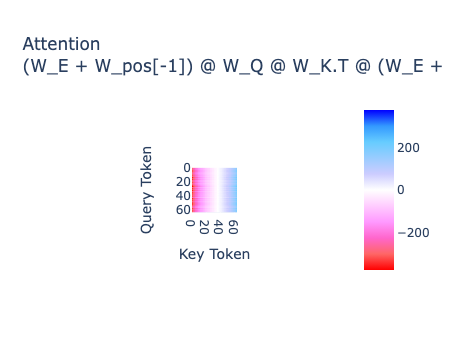

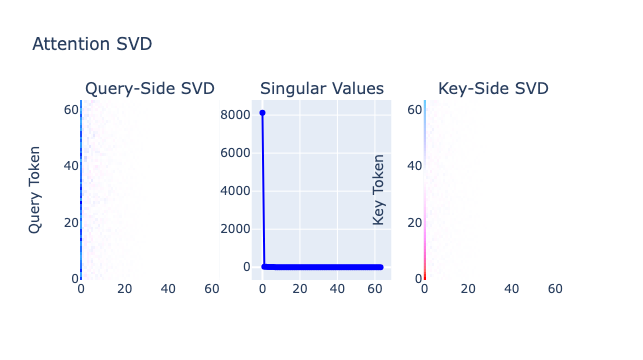

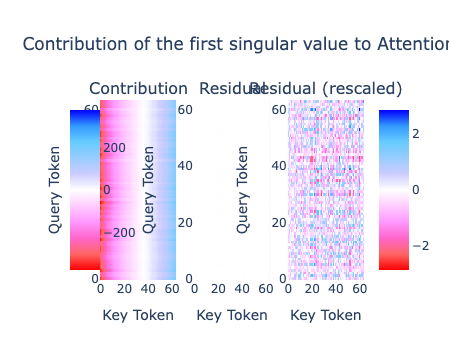

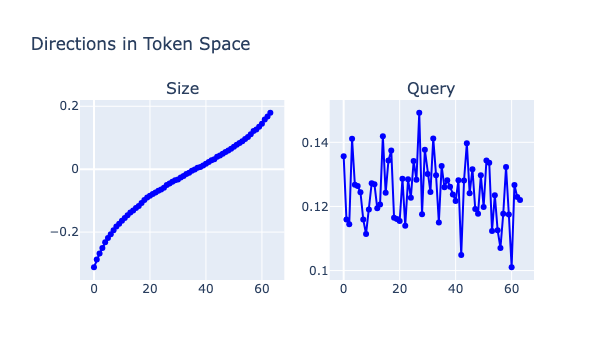

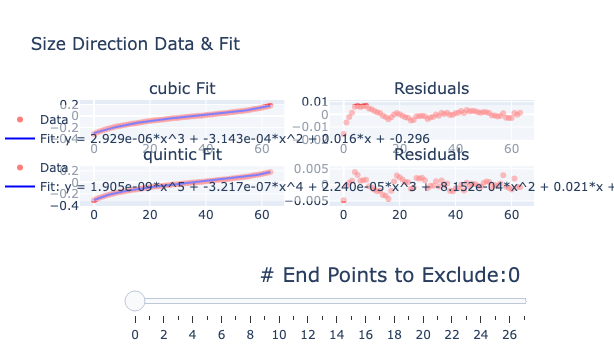

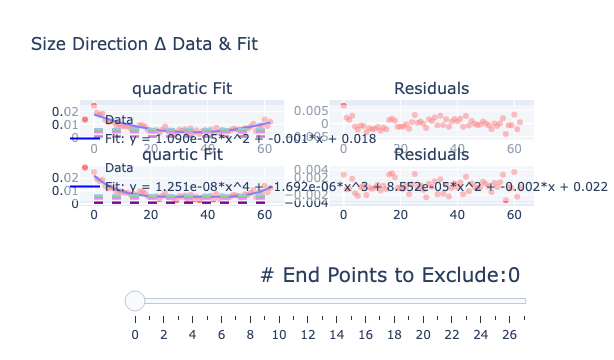

Size direction: tensor([-0.3118, -0.2873, -0.2682, -0.2506, -0.2322, -0.2186, -0.2068, -0.1942,
        -0.1823, -0.1735, -0.1636, -0.1548, -0.1463, -0.1377, -0.1310, -0.1236,
        -0.1173, -0.1078, -0.0983, -0.0900, -0.0843, -0.0790, -0.0739, -0.0682,
        -0.0646, -0.0587, -0.0503, -0.0451, -0.0396, -0.0351, -0.0325, -0.0265,
        -0.0214, -0.0149, -0.0116, -0.0047, -0.0013,  0.0043,  0.0071,  0.0118,
         0.0176,  0.0226,  0.0287,  0.0319,  0.0394,  0.0434,  0.0493,  0.0544,
         0.0593,  0.0646,  0.0713,  0.0776,  0.0836,  0.0885,  0.0958,  0.1025,
         0.1108,  0.1213,  0.1263,  0.1351,  0.1444,  0.1584,  0.1673,  0.1794])
Query direction: tensor([0.1357, 0.1159, 0.1145, 0.1411, 0.1268, 0.1264, 0.1245, 0.1159, 0.1114,
        0.1190, 0.1272, 0.1269, 0.1194, 0.1206, 0.1419, 0.1242, 0.1343, 0.1375,
        0.1165, 0.1161, 0.1154, 0.1286, 0.1140, 0.1285, 0.1227, 0.1342, 0.1283,
        0.1492, 0.1176, 0.1377, 0.1301, 0.1245, 0.1412, 0.1298, 0.1150, 0.1326,
      

In [19]:
from gbmi.analysis_utils import find_size_and_query_direction

(
    size_direction,
    query_direction,
    size_query_singular_value,
) = find_size_and_query_direction(model, plot_heatmaps=True, colorscale="Picnic_r")
print(
    f"Size direction: {size_direction}\nQuery direction: {query_direction}\nSingular value: {size_query_singular_value}"
)

### A couple of notes:
- SVD is only unique up to the sign of each singular vector.  PyTorch SVD gives us a negative query direction vector, so we negate both the query and size direction vectors.
- If we fit the size direction to a cubic (or quintic), the bounds on the errors might not actually give us enough information to ensure adjacent tokens are ordered correctly.  But if we fit the differences in size-direction overlap of adjacent tokens to a quadratic (or quartic), we see that all differences are positive, and so we can get monotonicity even with worst-case errors.

### Interpretation and relevance
- The first singular value is just over 8,000; the next singular value is just under 30, so to a first approximation there's only one thing going on.
- However, the remainder of the QK circuit (labeled "Residual" on the "Contribution of the first singular value to Attention" plot) is not actually small enough to neglect in all cases.
  - Looking at the "Size Direction Δ & Fit" plots, consider the "resid.max - resid.min (worst-case independent query)" line.  This line results from taking the remainder of the QK circuit, finding the maximum possible difference in attention, and scaling it according to the worst possible query token (the one which overlaps the least with the size direction).  The position of this line shows that the size direction is enough to explain the majority of cases (many sequences with ($i$, $i+1$) will have a comparatively large attention gap just based on the size direction, and most sequences with larger gaps will certainly pay more attention to the larger token), but not all of them.
  - Looking at the "(resid[i] - resid[i+1]).max (worst-case query)" line suggests that even accounting for exact attention values, the model might pay more attention to the smaller token!  Let's compute if this ever happens.

In [ ]:
print("The model pays more attention to the smaller token for the following seuqences:")
for minpos, qtok, ktokmin in find_backwards_attention(model):
    if qtok not in range(ktokmin, ktokmin + 2):
        descr = "(invalid! query token not in sequence)"
    elif minpos == 1 and qtok != ktokmin:
        descr = "(invalid! minimum in the query position but not equal to query token)"
    elif minpos == 0 and qtok != ktokmin + 1:
        descr = "(invalid! contradictory minimum position and query token constraints)"
    else:
        descr = "(valid!)"
    print(
        f"Tokens: {ktokmin}, {ktokmin+1};\tQuery: {qtok};\tPosition of the Minimum: {minpos}\t{descr}"
    )

The model pays more attention to the smaller token for the following seuqences:
Tokens: 42, 43;	Query: 1;	Position of the Minimum: 0	(invalid! query token not in sequence)
Tokens: 42, 43;	Query: 2;	Position of the Minimum: 0	(invalid! query token not in sequence)
Tokens: 35, 36;	Query: 8;	Position of the Minimum: 0	(invalid! query token not in sequence)
Tokens: 33, 34;	Query: 9;	Position of the Minimum: 0	(invalid! query token not in sequence)
Tokens: 42, 43;	Query: 12;	Position of the Minimum: 0	(invalid! query token not in sequence)
Tokens: 23, 24;	Query: 18;	Position of the Minimum: 0	(invalid! query token not in sequence)
Tokens: 42, 43;	Query: 18;	Position of the Minimum: 0	(invalid! query token not in sequence)
Tokens: 23, 24;	Query: 22;	Position of the Minimum: 0	(invalid! query token not in sequence)
Tokens: 42, 43;	Query: 22;	Position of the Minimum: 0	(invalid! query token not in sequence)
Tokens: 37, 38;	Query: 23;	Position of the Minimum: 0	(invalid! query token not in sequ

Notably, the model only pays more attention to smaller tokens when the query token is not present in the sequence.

### Compact Guarantees
- If we are trying to generate the most compact guarantee, neither the SVD nor the fit buy us much.  There are two locations in the proof where we might hope to gain in compactness by using the size direction:
  1. In explaining the behavior of the QK circuit.  But in generating a guarantee, we still have to establish that the particular QK circuit is doing the right thing, and I'm not sure how to compactly argue that the principle component of a product of matrices is what it is without multiplying out the matrices.  But if we multiply out the matrices, we have all of the pairwise attention weights, and so we don't need the size direction to explain the behavior of the QK circuit.
  2. In using the behavior of the QK circuit to explain the rest of the transformer.  Here in fact we get some benefit from having a compact description of *what* the QK circuit is doing.  Here we get a lot of benefit from some simple cut-off behavior (computing, for example, the minimal attention gap between tokens separated by at least two), but further dependencies between the QK circuit and the rest of the transformer seem to be more about the query direction than the size direction.

**Hypothesis**: In almost all cases (for almost all possible sequences), either:
1. The best reasoning we can do with the size direction isn't enough to get us 100% accuracy, and the loss will be rather sensitive to the exact attention values; or
2. A simple lower bound on the attention gap between non-adjacent tokens is enough to get us 100% accuracy, and the loss will be so insensitive to the exact attention values that we won't get much benefit from any approximation more detailed than a lower bound.

To test this hypothesis, we can compute, for each maximum token, how much attention needs to be on that token in order for the model to predict the correct output.

What does "needs to be" mean, though?
It could mean:
1. Given exactly how the rest of the transformer behaves, what's the cutoff for attention?
2. For some particular functional model of the rest of the transformer's behavior and bounds on the errors, what's the cutoff for attention?

or anything in between.

Let's compute the histogram of attention cutoffs for a variety of interpretations.

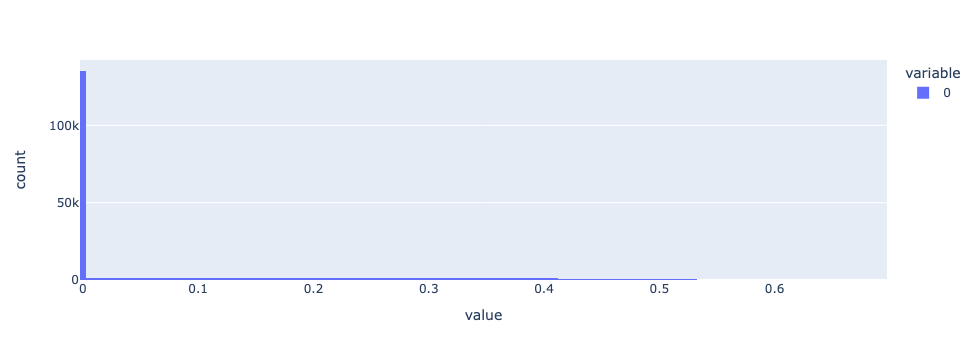

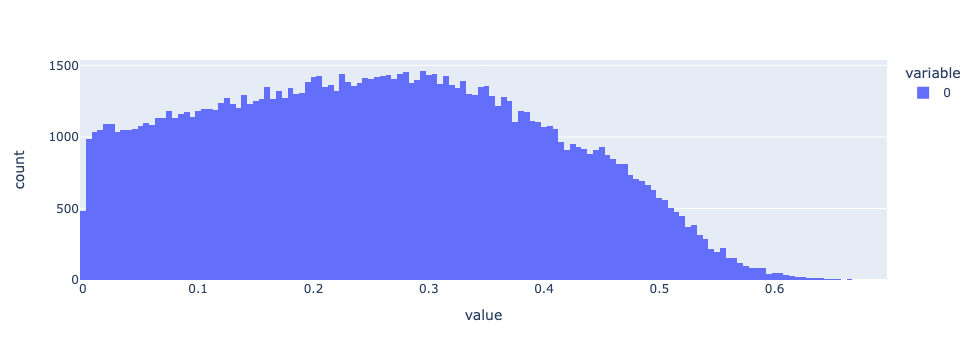

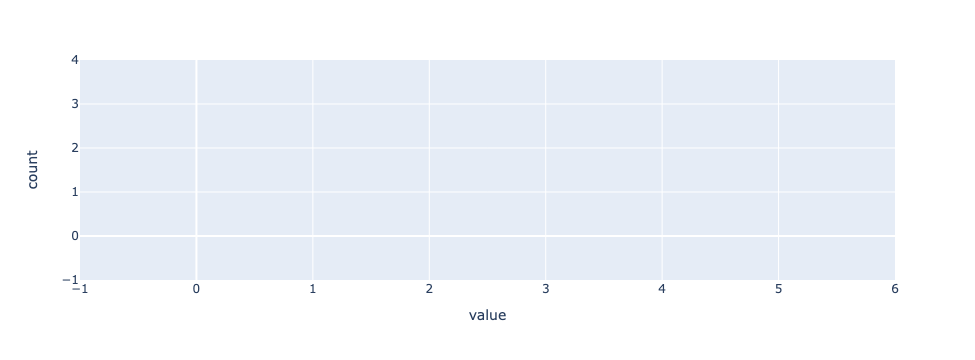

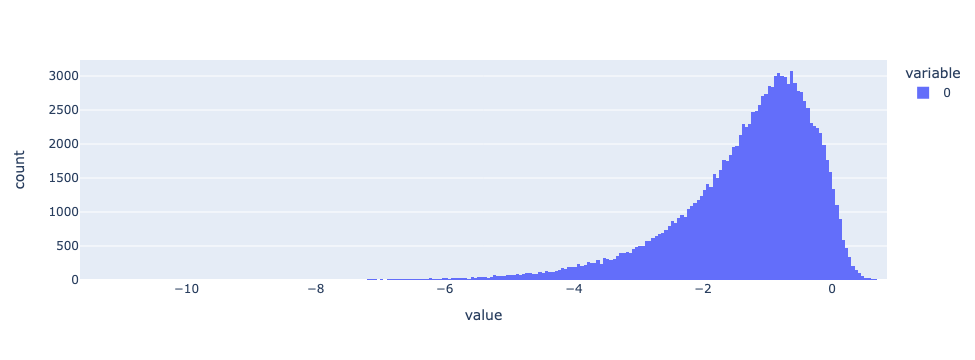

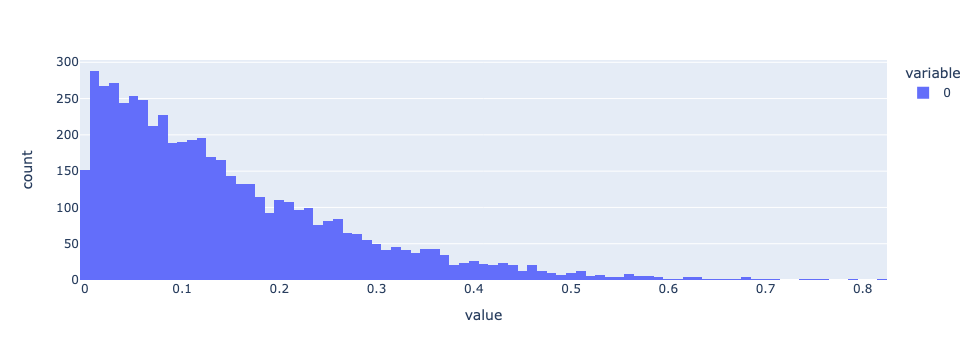

In [27]:
n_ctx, d_vocab, d_vocab_out = model.cfg.n_ctx, model.cfg.d_vocab, model.cfg.d_vocab_out
EUPU: Float[Tensor, "d_vocab d_vocab_out"] = EU_PU(model, pos=-1)
# assert EUPU.shape == (d_vocab, d_vocab_out), f"EUPU.shape = {EUPU.shape} != {(d_vocab, d_vocab_out)} = (d_vocab, d_vocab_out)"
EVOU: Float[Tensor, "d_vocab d_vocab_out"] = all_EVOU(model)
# assert EVOU.shape == (d_vocab, d_vocab_out), f"EVOU.shape = {EVOU.shape} != {(d_vocab, d_vocab_out)} = (d_vocab, d_vocab_out)"
PVOU: Float[Tensor, "n_ctx d_vocab_out"] = all_PVOU(model)
# assert PVOU.shape == (n_ctx, d_vocab_out), f"PVOU.shape = {PVOU.shape} != {(n_ctx, d_vocab_out)} = (n_ctx, d_vocab_out)"
# assume we vary only the attention, find the minimum attention required for the correct output
all_tokens: Float[Tensor, "batch n_ctx"] = compute_all_tokens(model)
all_tokens_max: Float[Tensor, "batch"] = all_tokens.max(dim=-1).values
all_tokens_max_pos: Float[Tensor, "batch"] = all_tokens.argmax(dim=-1)
all_tokens_EUPU: Float[Tensor, "batch d_vocab_out"] = EUPU[all_tokens[:, -1], :]
all_tokens_EVOU_PVOU: Float[Tensor, "batch n_ctx d_vocab_out"] = (
    EVOU[all_tokens, :] + PVOU
)
# to compute the minimum post-softmax attention required for the correct output, we center each output so the logit of the correct output is 0
# then we want to compute the minimum p such that p * (logit of incorrect output on max token) + (1 - p) * (logit of incorrect token on non-max token) + (logit of incorrect output on residual path) < 0
# or equivalently p * (logit of incorrect output on max token - logit of incorrect output on non-max token) < -(logit of incorrect output on residual path + logit of incorrect token on non-max token)
# or p * sign(logit of incorrect output on max token - logit of incorrect output on non-max token) < -(logit of incorrect output on residual path + logit of incorrect token on non-max token) / abs(logit of incorrect output on max token - logit of incorrect output on non-max token)
# if the logit of the incorrect output on EUPU + the max token is positive, we say nan (no attention is enough)
# if the logit of the incorrect output on the non-max token is negative, we say 0 (any amount of attention is enough)
all_tokens_EUPU -= all_tokens_EUPU[
    torch.arange(all_tokens_EUPU.shape[0]), all_tokens_max
][:, None]
for b in range(all_tokens_EVOU_PVOU.shape[0]):
    for n in range(all_tokens_EVOU_PVOU.shape[1]):
        all_tokens_EVOU_PVOU[b, n, :] = (
            all_tokens_EVOU_PVOU[b, n, :]
            - all_tokens_EVOU_PVOU[b, n, all_tokens_max[b]]
        )

# fold all_tokens_EUPU into all_tokens_EVOU_PVOU
all_tokens_EVOU_PVOU_max_token: Float[Tensor, "batch d_vocab_out"] = (
    all_tokens_EVOU_PVOU[
        torch.arange(all_tokens_EVOU_PVOU.shape[0]), all_tokens_max_pos, :
    ]
    + all_tokens_EUPU
)
# we're worst off when the attention on the non-max token is largest, so we take max
all_tokens_EVOU_PVOU_non_max_token_tmp = all_tokens_EVOU_PVOU.clone()
all_tokens_EVOU_PVOU_non_max_token_tmp[
    torch.arange(all_tokens_EVOU_PVOU.shape[0]), all_tokens_max_pos, :
] = -float("inf")
all_tokens_EVOU_PVOU_non_max_token: Float[Tensor, "batch d_vocab_out"] = (
    all_tokens_EVOU_PVOU_non_max_token_tmp.max(dim=-2).values + all_tokens_EUPU
)
attention_never_enough = all_tokens_EVOU_PVOU_max_token > 0
logit_diff = all_tokens_EVOU_PVOU_max_token - all_tokens_EVOU_PVOU_non_max_token
logit_gap = -all_tokens_EVOU_PVOU_non_max_token / logit_diff.abs()
# where logit_diff < 0, we want smallest p > -logit_gap
# where logit_diff > 0 we want smallest p < logit_gap
min_p_1 = -logit_gap[logit_diff < 0]
min_p_1 = torch.max(min_p_1, torch.zeros_like(min_p_1))
min_p_2 = logit_gap[logit_diff > 0]
min_p_2 = torch.min(min_p_2, torch.zeros_like(min_p_2))
min_p = torch.cat([min_p_1, min_p_2], dim=0)
# from analysis_utils import hist
hist(min_p)
hist(min_p[min_p != 0])
hist(min_p[min_p < 0])
# find pre-softmax
# min_p = weight on max = e^max / (e^max + e^non-max) = 1 / (1 + e^(non-max - max)
# e^(non_max - max) = 1 / min_p - 1
# non_max - max = log(1 / min_p - 1)
# max - non_max = -log(1 / min_p - 1)
min_attn = -(1 / min_p[min_p > 0] - 1).log()
hist(min_attn)
hist(min_attn[min_attn > 0])

# all_tokens_EVOU_PVOU_max_token - all_tokens_EVOU_PVOU_non_max_token
# -all_tokens_EVOU_PVOU_non_max_token / (all_tokens_EVOU_PVOU_max_token - all_tokens_EVOU_PVOU_non_max_token).abs()

# print(all_tokens_EUPU.shape)

HERE

There are numerous approximations to this computation we might want to consider:
1. For every sequence, how much attention needs to be on the correct token for predicting the correct output?
2. For each max token, for each position it could be in, for the worst-case (or average-case) query token compatible with that choice (determining the residual stream impact), for the worst-case (or average-case) non-max-token OV behavior (per-logit), how much attention needs to be on the max token for the max token logit to be higher than the logit corresponding to the other token?  (Here we'd also need to verify that the OV behavior has all diagonal entries higher than all off-diagonal entries in the same row, to ensure that we can find the worst case for each logit separately.)
3. For each max token, we can compute the smallest (or average) gap between the logit of that token and the logit of any other token, and then reduce across positions.  Then we can compute the largest (or average) gap between logits in the residual stream impact, and the largest (or average) gap between logits across all other copying behavior.  Finally we can compute how much attention needs to be on the max token to prevent the worst-case (or average) behavior of the rest of the transformer from outweighing the correct behavior on the max token.

Although there are even more approximations we might consider, let's zoom out to make sense of the landscape here.  When picking an approximation to compute, we should ask: "What interpretation are we validating with this computation?"

1. The first approximation validates the hypothesis "the model (somehow) pays enough more attention to the largest token, where 'enough' means: enough that whatever other computations are going on, the model outputs the correct answer".  Notably, this doesn't explain very much.
2. The second approximation validates the hypothesis "for every sequence, find the maximum, and consider all sequences with the same maximum in the same position; whatever computation is going on in the rest of the model, it's sufficiently invariant over the details of the rest of the sequence that the model outputs the correct answer".
3. The third approximation validates the hypothesis "the behavior on the non-max token and the bahvior on the skip-connection is irrelevant noise; we pay enough more attention to the max token that we can neglect everything else that happens beyond getting a simple bound on how much it perturbs the output".

Notably, the computation for 3 is (slightly) more compact than the computation for 2 (which itself is slightly more compact than the computation for 1), which, to our eyes at least, is minor evidence in favor of compact proofs being a good proxy for human interpretability.

However, in the max-of-2 model, exhaustive enumeration, which is exponential in the sequence length, is indistinguishable from a pairwise quadratic analysis (quadratic and exponential are the same when the exponent is 2).  There are not many asymptotic gains to be had here, and compactness differences are somewhat harder to see.

Let's plot how much attention is given to the max token in each sequence, and how much attention is required, according to each of these three computations.

In [ ]:
# def compute_attention_to_max(model: HookedTransformer) -> torch.Tensor:
#     """Compute the attention given to the max token in each sequence."""
#     n_ctx, d_vocab = model.cfg.n_ctx, model.cfg.d_vocab
#     # pre soft-max
#     all_attention_scores = all_attention_scores(model)
#     assert all_attention_scores.shape == (n_ctx, d_vocab, d_vocab), f"all_attention.shape = {all_attention_scores.shape} != ({n_ctx}, {d_vocab}, {d_vocab}) = (n_ctx_k, d_vocab_k, d_vocab_q)"

#     # compute soft-max


#     all_tokens = compute_all_tokens(model)
#     all_logits = model(all_tokens)
#     expected_max = all_tokens.max(dim=-1).values
#     predicted_max = all_logits[..., -1, :].argmax(dim=-1)
#     return (all_logits.gather(-1, expected_max.unsqueeze(-1)) * (predicted_max == expected_max).float()).sum(dim=1)

  HERE
 # %%
 # compute EU PU
 W_E, W_pos, W_U = model.W_E, model.W_pos, model.W_U
 print(W_E.shape, W_pos.shape, W_U.shape)
 line(W_pos[-1] @ W_U)
 imshow(W_E @ W_U)
 imshow((W_E + W_pos[-1]) @ W_U)
 analyze_svd(W_E @ W_U)
 analyze_svd((W_E + W_pos[-1]) @ W_U)
 # %%
 # compute OV
 import analysis_utils
 analysis_utils.calculate_OV_of_pos_embed(model)
 analysis_utils.calculate_copying(model)
 # %%
 W_E, W_pos, W_U, W_V, W_O = model.W_E, model.W_pos, model.W_U, model.W_V, model.W_O
 analyze_svd(W_E @ W_V[0, 0] @ W_O[0, 0] @ W_U)
 # %%

In [ ]:
# import analysis_utils
# reload analysis_utils module
# import importlib
# importlib.reload(analysis_utils)
# analysis_utils.analyze_EVOU(model, scale_by_singular_value=False)
# analysis_utils.analyze_PVOU(model)
# analysis_utils.analyze_PU(model)
# analysis_utils.analyze_EU(model)
analyze_EVOU(model, scale_by_singular_value=False)
analyze_PVOU(model)
analyze_PU(model)
analyze_EU(model)